<a href="https://colab.research.google.com/github/maayaikeda/syllable_classifier/blob/main/audio.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Syllable classifier

## Objective:

In songbird research, researchers manipulate the brain to see if it effects the birds' singing behavior. Hoever, analyzing different features of thousands songs takes a long time. Here, I used deep learning to develop a classifier that segments and classify the elements (syllables) of songs. 

Preparation:
1.   Filter audio file
2.   Segment files into syllables
3.   Label the files

Train the classifier:
4.   Train the classifier

Use the classifier: 
5.  The classifier can process, segment, and classifier the syllables 







## Prep

### Set up packages

In [ ]:
!pip install -Uqq fastbook

     |████████████████████████████████| 727kB 4.4MB/s 
     |████████████████████████████████| 1.1MB 12.6MB/s 
     |████████████████████████████████| 194kB 23.1MB/s 
     |████████████████████████████████| 51kB 6.8MB/s 
     |████████████████████████████████| 51kB 7.9MB/s 
     |████████████████████████████████| 51kB 7.6MB/s 
     |████████████████████████████████| 92kB 9.3MB/s 
     |████████████████████████████████| 40kB 6.1MB/s 
     |████████████████████████████████| 51kB 7.7MB/s 
     |████████████████████████████████| 61kB 8.1MB/s 
     |████████████████████████████████| 2.6MB 19.4MB/s 


In [ ]:
import fastbook
fastbook.setup_book()

Mounted at /content/gdrive


In [ ]:
from fastai.vision.all import *
from fastbook import *

In [ ]:
from fastai.vision.widgets import *

In [ ]:
!pip install pydub

In [ ]:
!pip install soundfile

In [ ]:
from pydub import AudioSegment
from pydub.silence import split_on_silence
import matplotlib.pyplot as plt

In [ ]:
from IPython.display import Audio
from scipy.io import wavfile
import soundfile as sf

In [ ]:
from scipy import signal
import os
from scipy.io import wavfile

import numpy as np
import re



## Take a look at a sample file 

### Set directory and files

In [ ]:
# Set directory
%cd "/content/gdrive/My Drive"

/content/gdrive/My Drive


In [ ]:
# Inputs

In [ ]:
bird = 'G505'
path = 'G505_43739.25261173_10_1_7_1_1.wav'

### Hear and visualize file

In [ ]:
Audio(path)

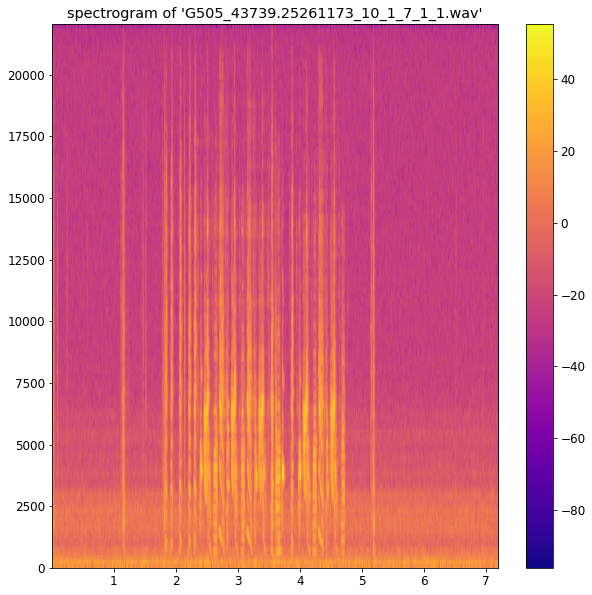

In [ ]:
frame_rate, sound_info = wavfile.read(path)
plt.figure(num=None, figsize=(10, 10))
plt.specgram(sound_info, Fs=frame_rate, cmap = 'plasma')
plt.title('spectrogram of %r' % path)
plt.colorbar()

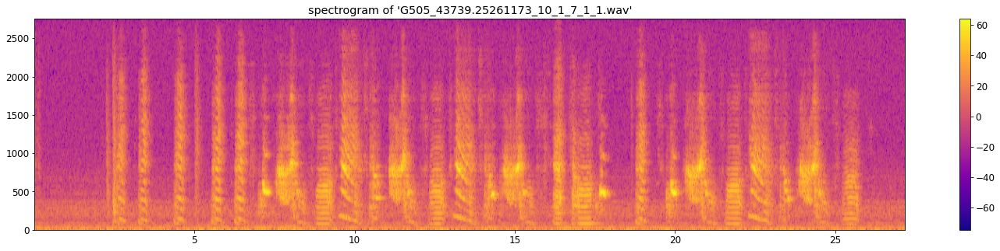

In [ ]:
segmented = AudioSegment.from_wav(path)[1500:4900]
segmented.export("segmented.wav", format='wav')
frame_rate, sound_info = wavfile.read('segmented.wav')
plt.figure(num=None, figsize=(25, 5))
plt.specgram(sound_info, Fs=frame_rate/8, cmap = 'plasma')
plt.title('spectrogram of %r' % path)
plt.savefig("song.png")
plt.colorbar()

### Filter file

In [ ]:
# Filter file high pass

sr, x = wavfile.read(path)      # 16-bit mono 44.1 khz

b = signal.firwin(101, cutoff=300, fs=sr, pass_zero='highpass')

x = signal.lfilter(b, [1.0], x)

wavfile.write('lowfiltered.wav', sr, x.astype(np.int16))

In [ ]:
sr

44100

In [ ]:
# Filter file low pass 



sr, x = wavfile.read('lowfiltered.wav')      # 16-bit mono 44.1 khz

b = signal.firwin(101, cutoff=20000, fs=sr, pass_zero='lowpass')

x = signal.lfilter(b, [1.0], x)

wavfile.write('highfiltered1.wav', sr, x.astype(np.int16))

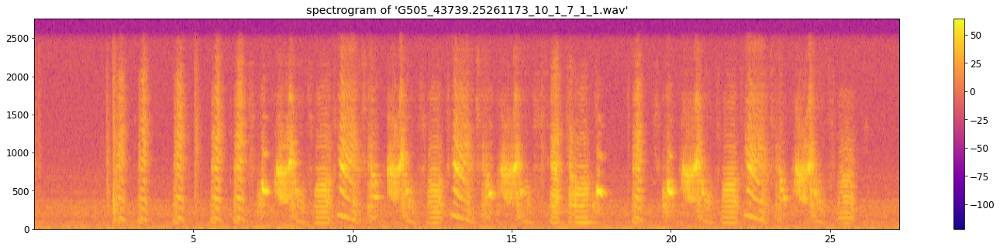

In [ ]:
segmented = AudioSegment.from_wav('highfiltered1.wav')[1500:4900]
segmented.export("segmented.wav", format='wav')
frame_rate, sound_info = wavfile.read('segmented.wav')
plt.figure(num=None, figsize=(25, 5))
plt.specgram(sound_info, Fs=frame_rate/8, cmap = 'plasma')
plt.title('spectrogram of %r' % path)

plt.colorbar()

### Segment file int pieces by silence

In [ ]:
# Segment file into pieces with syllables
song = AudioSegment.from_wav('highfiltered1.wav')
# Split track where the silence is 5 miliseconds or more and get chunks using 
# the imported function.
chunks = split_on_silence (
    # Use the loaded audio.
    song, 
    # Specify that a silent chunk must be at least 2 seconds or 2000 ms long.
    min_silence_len = 5,
    # Consider a chunk silent if it's quieter than -40 dBFS.
    # (You may want to adjust this parameter.)
    silence_thresh = -40
)

In [ ]:
len(chunks)

33

In [ ]:
os.path.isfile('/content/gdrive/My Drive/audio/filtered')

False

In [ ]:
p = '/content/gdrive/My Drive/audio/filtered'
if not os.path.exists(p):
  os.mkdir(p)


In [ ]:
# export all audio segments into audio folder
for chunk in chunks:
  chunk.export("/content/gdrive/My Drive/audio/filtered/chunk_" + str(chunks.index(chunk)) + ".wav", format="wav")

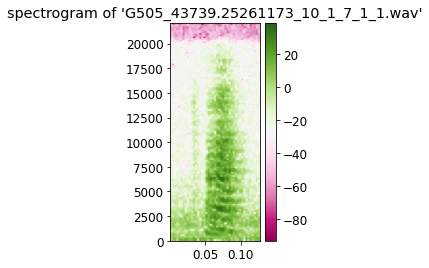

In [ ]:
frame_rate, sound_info = wavfile.read('audio/filtered/chunk_23.wav')
plt.figure(num=None, figsize=(2, 4))
plt.specgram(sound_info, Fs=frame_rate, cmap = 'PiYG')
plt.title('spectrogram of %r' % path)
plt.colorbar()

### Visualize all chunks and loudness (dB)

In [ ]:
## testing measuring average db
sound = AudioSegment.from_file('audio/filtered/chunk_23.wav')
sound.dBFS

-33.0783104820136

In [ ]:
# retrieve all wave file names in audio folder
import glob
filenames = glob.glob('/content/gdrive/My Drive/audio/filtered/*.wav')


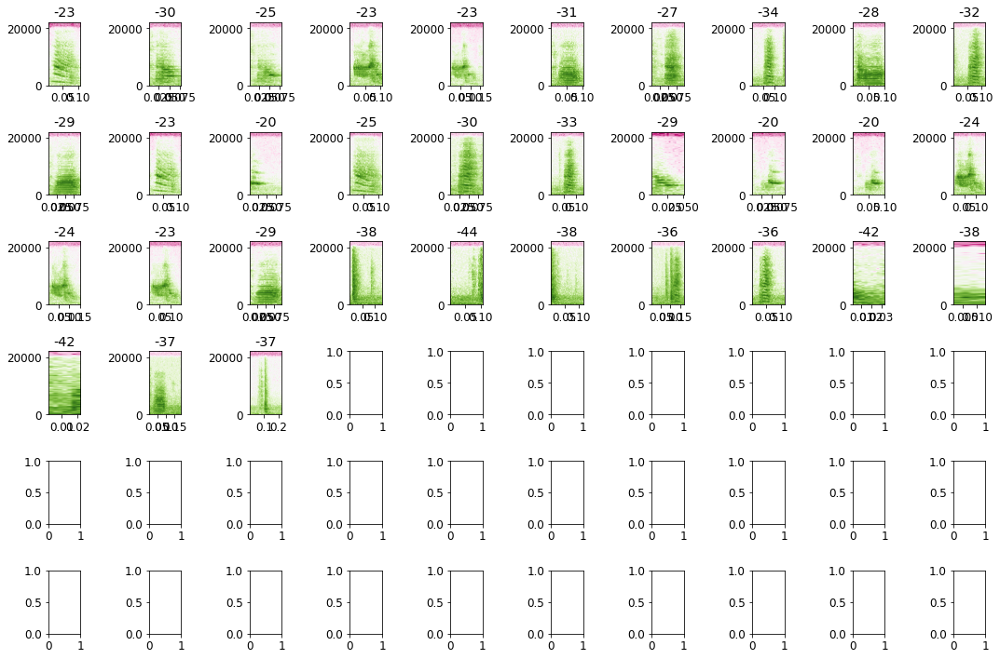

In [ ]:
## plot all segmented audio files
fig, axs = plt.subplots(6,10, figsize=(15,10))



for file in filenames[0:10]:
  frame_rate, sound_info = wavfile.read(file)
  axs[0,int(filenames.index(file))].specgram(sound_info, Fs=frame_rate, cmap = 'PiYG')
  axs[0,int(filenames.index(file))].set_title(str(round(AudioSegment.from_file(file).dBFS)))

for file in filenames[10:20]:
  frame_rate, sound_info = wavfile.read(file)
  axs[1,int(filenames.index(file))-10].specgram(sound_info, Fs=frame_rate, cmap = 'PiYG')
  axs[1,int(filenames.index(file))-10].set_title(str(round(AudioSegment.from_file(file).dBFS)))

for file in filenames[20:30]:
  frame_rate, sound_info = wavfile.read(file)
  axs[2,int(filenames.index(file))-20].specgram(sound_info, Fs=frame_rate, cmap = 'PiYG')
  axs[2,int(filenames.index(file))-20].set_title(str(round(AudioSegment.from_file(file).dBFS)))

for file in filenames[30:40]:
  frame_rate, sound_info = wavfile.read(file)
  axs[3,int(filenames.index(file))-30].specgram(sound_info, Fs=frame_rate, cmap = 'PiYG')
  axs[3,int(filenames.index(file))-30].set_title(str(round(AudioSegment.from_file(file).dBFS)))

for file in filenames[40:50]:
  frame_rate, sound_info = wavfile.read(file)
  axs[4,int(filenames.index(file))-50].specgram(sound_info, Fs=frame_rate, cmap = 'PiYG')
  axs[4,int(filenames.index(file))-50].set_title(str(round(AudioSegment.from_file(file).dBFS)))

for file in filenames[50:60]:
  frame_rate, sound_info = wavfile.read(file)
  axs[5,int(filenames.index(file))-50].specgram(sound_info, Fs=frame_rate, cmap = 'PiYG')
  axs[5,int(filenames.index(file))-50].set_title(str(round(AudioSegment.from_file(file).dBFS)))

for file in filenames[60:70]:
  frame_rate, sound_info = wavfile.read(file)
  axs[5,int(filenames.index(file))-60].specgram(sound_info, Fs=frame_rate, cmap = 'PiYG')
  axs[5,int(filenames.index(file))-60].set_title(str(round(AudioSegment.from_file(file).dBFS)))




plt.tight_layout()
plt.show()

### Remove files less than -35 db (to see if it can filter out irrelavent chunks)

In [ ]:
# remove all files with dB lower than -35
for file in filenames:
  if round(AudioSegment.from_file(file).dBFS) <-35:
    os.remove(file)




In [ ]:
# Count how many files are left
filenames = glob.glob("audio/filtered/*.wav")
len(filenames)

23

In [ ]:
# Print out all files that are left
filenames

['audio/filtered/chunk_11.wav',
 'audio/filtered/chunk_12.wav',
 'audio/filtered/chunk_17.wav',
 'audio/filtered/chunk_13.wav',
 'audio/filtered/chunk_18.wav',
 'audio/filtered/chunk_15.wav',
 'audio/filtered/chunk_19.wav',
 'audio/filtered/chunk_5.wav',
 'audio/filtered/chunk_20.wav',
 'audio/filtered/chunk_6.wav',
 'audio/filtered/chunk_26.wav',
 'audio/filtered/chunk_16.wav',
 'audio/filtered/chunk_22.wav',
 'audio/filtered/chunk_27.wav',
 'audio/filtered/chunk_7.wav',
 'audio/filtered/chunk_23.wav',
 'audio/filtered/chunk_29.wav',
 'audio/filtered/chunk_8.wav',
 'audio/filtered/chunk_24.wav',
 'audio/filtered/chunk_9.wav',
 'audio/filtered/chunk_30.wav',
 'audio/filtered/chunk_25.wav',
 'audio/filtered/chunk_10.wav']

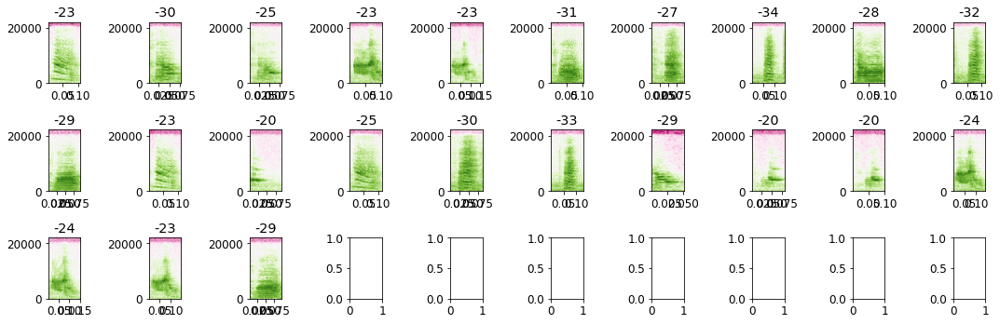

In [ ]:
# Plot all files left
fig, axs = plt.subplots(3,10, figsize=(15,5))



for file in filenames[0:10]:
  frame_rate, sound_info = wavfile.read(file)
  axs[0,int(filenames.index(file))].specgram(sound_info, Fs=frame_rate, cmap = 'PiYG')
  axs[0,int(filenames.index(file))].set_title(str(round(AudioSegment.from_file(file).dBFS)))

for file in filenames[10:20]:
  frame_rate, sound_info = wavfile.read(file)
  axs[1,int(filenames.index(file))-10].specgram(sound_info, Fs=frame_rate, cmap = 'PiYG')
  axs[1,int(filenames.index(file))-10].set_title(str(round(AudioSegment.from_file(file).dBFS)))

for file in filenames[20:30]:
  frame_rate, sound_info = wavfile.read(file)
  axs[2,int(filenames.index(file))-20].specgram(sound_info, Fs=frame_rate, cmap = 'PiYG')
  axs[2,int(filenames.index(file))-20].set_title(str(round(AudioSegment.from_file(file).dBFS)))





plt.tight_layout()
plt.show()

### Conver files to images (png) and save them

In [ ]:

p = '/content/gdrive/My Drive/audio/filtered/images'
if not os.path.exists(p):
  os.mkdir(p)

In [ ]:
%ls '/content/gdrive/My Drive/audio/filtered/'

chunk_10.wav  chunk_16.wav  chunk_22.wav  chunk_27.wav  chunk_7.wav
chunk_11.wav  chunk_17.wav  chunk_23.wav  chunk_29.wav  chunk_8.wav
chunk_12.wav  chunk_18.wav  chunk_24.wav  chunk_30.wav  chunk_9.wav
chunk_13.wav  chunk_19.wav  chunk_25.wav  chunk_5.wav   images/
chunk_15.wav  chunk_20.wav  chunk_26.wav  chunk_6.wav


In [ ]:
filenames[0][15:len(filenames[0])]

'chunk_11.wav'

In [ ]:
for file in filenames:
  frame_rate, sound_info = wavfile.read(file)
  plt.figure(num=None, figsize=(2, 4))
  plt.specgram(sound_info, Fs=frame_rate, cmap = 'PiYG')
  plt.savefig('/content/gdrive/My Drive/audio/filtered/images/'+file[15:len(file)]+".png")


### Create files to sort images in

In [ ]:
syllables = 'i','A','B','C','D'
clippath = Path('/content/gdrive/My Drive/audio/clips')

In [ ]:
if not clippath.exists():
  clippath.mkdir()
  for o in syllables:
    dest = (clippath/o)
    dest.mkdir(exist_ok=True)

In [ ]:
%ls 'audio/clips/'

## Sort the files using ImagesClearner

In [ ]:
# Sort
fns = get_image_files('audio/')
w = ImagesCleaner(('i','A','B','C','D'))
w.set_fns(fns)
w

Box(children=(VBox(children=(Output(layout=Layout(height='128px')), Dropdown(layout=Layout(width='max-content'…

In [ ]:
# list of files to delete
w.delete()

In [ ]:
# list of files to sort 
w.change()

In [ ]:
# remove the files from directory
for idx in w.delete(): w.fns[idx].unlink()

In [ ]:
# move files in the right folder
for idx,cat in w.change(): shutil.move(str(w.fns[idx]), clippath/cat)

In [ ]:
# list of images in A
%ls 'audio/clips/A'

## Train model using more song files

Everything looks good with the test song file. 
Now, setup and train model using more song files.

In [ ]:
# Next: 1 grab all song files, 2 segment them, 3 save the chunk wav files, 4 sort files based on db, 
# 5 convert to image, 6 manually sort images

### Load and process song files as test file

**Before running this, create a song file and load more song files in here.**

In [ ]:
filenames = glob.glob('/content/gdrive/My Drive/audio/songs/*.wav')

In [ ]:
filenames

['/content/gdrive/My Drive/audio/songs/G505_43739.36969178_10_1_10_16_9.wav',
 '/content/gdrive/My Drive/audio/songs/G505_43739.37072355_10_1_10_17_52.wav',
 '/content/gdrive/My Drive/audio/songs/G505_43739.37589170_10_1_10_26_29.wav',
 '/content/gdrive/My Drive/audio/songs/G505_43739.37627376_10_1_10_27_7.wav',
 '/content/gdrive/My Drive/audio/songs/G505_43739.38651752_10_1_10_44_11.wav',
 '/content/gdrive/My Drive/audio/songs/G505_43739.40596252_10_1_11_16_36.wav',
 '/content/gdrive/My Drive/audio/songs/G505_43739.40604353_10_1_11_16_44.wav',
 '/content/gdrive/My Drive/audio/songs/G505_43739.40929180_10_1_11_22_9.wav',
 '/content/gdrive/My Drive/audio/songs/G505_43739.46322624_10_1_12_52_2.wav',
 '/content/gdrive/My Drive/audio/songs/G505_43739.56802865_10_1_15_46_42.wav',
 '/content/gdrive/My Drive/audio/songs/G505_43739.56823973_10_1_15_47_3.wav',
 '/content/gdrive/My Drive/audio/songs/G505_43739.56832270_10_1_15_47_12.wav',
 '/content/gdrive/My Drive/audio/songs/G505_43739.5734175

In [ ]:
# Combine all files to one
sound = AudioSegment.from_file(filenames[0])

for file in filenames:
  soundtemp = AudioSegment.from_file(file)
  sound = sound.append(soundtemp)

sound.export('audio/combined.wav',format='wav')

<_io.BufferedRandom name='audio/combined.wav'>

In [ ]:

# Filter file high pass



sr, x = wavfile.read('audio/combined.wav')      # 16-bit mono 44.1 khz

b = signal.firwin(101, cutoff=300, fs=sr, pass_zero='highpass')

x = signal.lfilter(b, [1.0], x)

wavfile.write('audio/combinedlowfiltered.wav', sr, x.astype(np.int16))

In [ ]:

# Filter file low pass



sr, x = wavfile.read('audio/combinedlowfiltered.wav')      # 16-bit mono 44.1 khz

b = signal.firwin(101, cutoff=20000, fs=sr, pass_zero='lowpass')

x = signal.lfilter(b, [1.0], x)

wavfile.write('audio/combinedhighfiltered.wav', sr, x.astype(np.int16))

In [ ]:
%ls 'audio/'


In [ ]:
# Segment file
song = AudioSegment.from_wav('/content/gdrive/My Drive/audio/combinedhighfiltered.wav')
# Split track where the silence is 5 miliseconds or more and get chunks using 
# the imported function.
chunks = split_on_silence (
    # Use the loaded audio.
    song, 
    # Specify that a silent chunk must be at least 2 seconds or 2000 ms long.
    min_silence_len = 5,
    # Consider a chunk silent if it's quieter than -40 dBFS.
    # (You may want to adjust this parameter.)
    silence_thresh = -40
)

In [ ]:
# Check how many segments
len(chunks)

858

In [ ]:
# remove everything with db too low
for chunk in chunks:
  if round(chunk.dBFS) <-35:
    chunks.remove(chunk)


In [ ]:
len(chunks)

730

In [ ]:
# remove everything with db too high
for chunk in chunks:
  if round(chunk.dBFS) >-10:
    chunks.remove(chunk)

In [ ]:
len(chunks)

730

In [ ]:
# run this if there's no chunks folder
p = '/content/gdrive/My Drive/audio/chunks'
if not os.path.exists(p):
  os.mkdir(p)

In [ ]:
# export all audio segments into chunks folder
for chunk in chunks:
  chunk.export("audio/chunks/chunk_" + str(chunks.index(chunk)) + ".wav", format="wav")

In [ ]:
filenames = glob.glob('audio/chunks/*.wav')

In [ ]:
len(filenames)

In [ ]:
# run this if there's no images folder
# os.mkdir('audio/images')
p = '/content/gdrive/My Drive/audio/images'
if not os.path.exists(p):
  os.mkdir(p)

In [ ]:
%pwd

In [ ]:
str(filenames[0])[13:len(str(file))]

In [ ]:
# convert to png

for file in filenames:
  frame_rate, sound_info = wavfile.read(file)
  plt.figure(num=None, figsize=(2, 4))
  plt.specgram(sound_info, Fs=frame_rate, cmap = 'PiYG')
  plt.savefig('audio/images/'+str(file)[13:len(str(file))]+".png")



### Sort the chunks into the syllable files.
Run the two lines over and over until there's at least 50 files in each folder.

In [ ]:
# Sort
fns = get_image_files('audio/images/')
w = ImagesCleaner(('i','A','B','C','D'))
w.set_fns(fns)
w

Box(children=(VBox(children=(Output(layout=Layout(height='128px')), Dropdown(layout=Layout(width='max-content'…

In [ ]:
# remove the files from directory
for idx in w.delete(): w.fns[idx].unlink()
# move files in the right folder
# if it doesn't exist already

for idx,cat in w.change():
  p = clippath/cat/str(w.fns[idx])[13:len(str(w.fns[idx]))]
  if not os.path.exists(p):
    shutil.move(str(w.fns[idx]), clippath/cat)
  else:
    pass


In [ ]:
%ls '/content/gdrive/My Drive/audio/clips/A/'

chunk_109.wav.png  chunk_164.wav.png  chunk_236.wav.png  chunk_51.wav.png
chunk_113.wav.png  chunk_168.wav.png  chunk_242.wav.png  chunk_5.wav.png
chunk_117.wav.png  chunk_172.wav.png  chunk_246.wav.png  chunk_64.wav.png
chunk_121.wav.png  chunk_176.wav.png  chunk_24.wav.png   chunk_68.wav.png
chunk_125.wav.png  chunk_17.wav.png   chunk_250.wav.png  chunk_72.wav.png
chunk_129.wav.png  chunk_212.wav.png  chunk_258.wav.png  chunk_76.wav.png
chunk_12.wav.png   chunk_216.wav.png  chunk_25.wav.png   chunk_80.wav.png
chunk_134.wav.png  chunk_21.wav.png   chunk_262.wav.png  chunk_84.wav.png
chunk_13.wav.png   chunk_220.wav.png  chunk_266.wav.png  chunk_8.wav.png
chunk_143.wav.png  chunk_224.wav.png  chunk_269.wav.png  chunk_90.wav.png
chunk_147.wav.png  chunk_228.wav.png  chunk_29.wav.png   chunk_94.wav.png
chunk_151.wav.png  chunk_22.wav.png   chunk_300.wav.png  chunk_99.wav.png
chunk_160.wav.png  chunk_232.wav.png  chunk_39.wav.png   chunk_9.wav.png


In [ ]:
len(glob.glob('/content/gdrive/My Drive/audio/images/*.png'))

In [ ]:
%ls '/content/gdrive/My Drive/audio/clips/i/'

chunk_103.wav.png  chunk_209.wav.png  chunk_299.wav.png  chunk_6.wav.png
chunk_107.wav.png  chunk_20.wav.png   chunk_2.wav.png    chunk_78.wav.png
chunk_108.wav.png  chunk_210.wav.png  chunk_3.wav.png    chunk_79.wav.png
chunk_11.wav.png   chunk_211.wav.png  chunk_4.wav.png    chunk_7.wav.png
chunk_142.wav.png  chunk_23.wav.png   chunk_50.wav.png   chunk_89.wav.png
chunk_157.wav.png  chunk_294.wav.png  chunk_5.wav.png    chunk_97.wav.png
chunk_158.wav.png  chunk_295.wav.png  chunk_60.wav.png   chunk_98.wav.png
chunk_159.wav.png  chunk_296.wav.png  chunk_61.wav.png
chunk_1.wav.png    chunk_297.wav.png  chunk_62.wav.png
chunk_208.wav.png  chunk_298.wav.png  chunk_63.wav.png


### Set up data and model

In [ ]:

clippath = Path('/content/gdrive/My Drive/audio/clips/')

In [ ]:
path = clippath

In [ ]:
# create datablock split data to valid =0.2, set to pad mode, label (file names)
syllables = DataBlock(
    blocks=(ImageBlock, CategoryBlock), 
    get_items=get_image_files, 
    splitter=RandomSplitter(valid_pct=0.2, seed=42),
    get_y=parent_label,
    item_tfms=Resize(128, ResizeMethod.Pad, pad_mode='zeros'))

In [ ]:
dls = syllables.dataloaders(path)

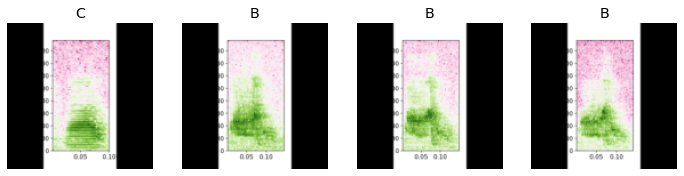

In [ ]:
syllables = syllables.new(item_tfms=Resize(128, ResizeMethod.Pad, pad_mode='zeros'))
dls = syllables.dataloaders(path)
dls.valid.show_batch(max_n=4, nrows=1)

### Train model and adjust 

In [ ]:
# Train model with simple params
learn = cnn_learner(dls, resnet18, metrics=error_rate)
learn.fine_tune(10)

Downloading: "https://download.pytorch.org/models/resnet18-5c106cde.pth" to /root/.cache/torch/hub/checkpoints/resnet18-5c106cde.pth


epoch,train_loss,valid_loss,error_rate,time
0,2.770129,2.937315,0.948718,00:22


epoch,train_loss,valid_loss,error_rate,time
0,2.515229,2.475558,1.000000,00:15
1,2.292045,1.908158,0.692308,00:18
2,2.036519,1.558382,0.589744,00:16
3,1.761285,1.295000,0.538462,00:16
4,1.542697,0.976411,0.384615,00:15
5,1.364859,0.672818,0.256410,00:15
6,1.232297,0.446838,0.179487,00:15
7,1.103869,0.300714,0.102564,00:15
8,0.996980,0.227241,0.076923,00:15
9,0.916820,0.196059,0.051282,00:15


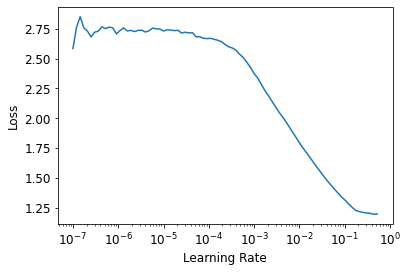

In [ ]:

learn = cnn_learner(dls, resnet18, metrics=error_rate)
lr_min,lr_steep = learn.lr_find()

In [ ]:
print(f"Minimum/10: {lr_min:.2e}, steepest point: {lr_steep:.2e}")

Minimum/10: 4.37e-02, steepest point: 1.20e-03


In [ ]:
learn = cnn_learner(dls, resnet18, metrics=error_rate)
learn.fine_tune(10)

epoch,train_loss,valid_loss,error_rate,time
0,2.691522,2.270522,0.871795,00:02


epoch,train_loss,valid_loss,error_rate,time
0,2.210366,2.195313,0.871795,00:02
1,2.043674,1.953016,0.897436,00:02
2,1.854598,1.628491,0.794872,00:02
3,1.676278,1.268668,0.461538,00:02
4,1.481898,0.924806,0.307692,00:02
5,1.298256,0.658282,0.282051,00:02
6,1.139300,0.462352,0.205128,00:02
7,1.019458,0.339723,0.179487,00:02
8,0.918248,0.281231,0.102564,00:02
9,0.841052,0.265203,0.076923,00:02


In [ ]:
learn = cnn_learner(dls, resnet18, metrics=error_rate)
learn.fine_tune(5, base_lr=3e-3)

epoch,train_loss,valid_loss,error_rate,time
0,2.844731,2.010473,0.897436,00:02


epoch,train_loss,valid_loss,error_rate,time
0,2.070288,1.768238,0.820513,00:02
1,1.803739,1.701701,0.743590,00:02
2,1.579414,1.521344,0.589744,00:02
3,1.347728,1.204170,0.487179,00:02
4,1.163428,0.913159,0.282051,00:02


In [ ]:
learn = cnn_learner(dls, resnet34, metrics=error_rate)
learn.fine_tune(5)

Downloading: "https://download.pytorch.org/models/resnet34-333f7ec4.pth" to /root/.cache/torch/hub/checkpoints/resnet34-333f7ec4.pth


epoch,train_loss,valid_loss,error_rate,time
0,2.813158,2.137524,0.717949,00:02


epoch,train_loss,valid_loss,error_rate,time
0,2.372715,1.622793,0.692308,00:02
1,2.221752,1.417213,0.641026,00:02
2,2.069651,1.235775,0.512820,00:02
3,1.929988,1.093657,0.307692,00:02
4,1.765440,0.990794,0.333333,00:02


In [ ]:
learn = cnn_learner(dls, resnet18, metrics=error_rate)
learn.fine_tune(10, freeze_epochs = 3)

epoch,train_loss,valid_loss,error_rate,time
0,2.530444,2.359590,0.743590,00:02
1,2.307801,2.088228,0.769231,00:02
2,2.047164,1.691594,0.589744,00:02


epoch,train_loss,valid_loss,error_rate,time
0,1.485882,1.418278,0.512820,00:02
1,1.391151,1.139922,0.410256,00:02
2,1.247567,0.885325,0.333333,00:02
3,1.071692,0.695738,0.282051,00:02
4,0.928316,0.517000,0.205128,00:02
5,0.813567,0.363339,0.153846,00:02
6,0.705219,0.273223,0.076923,00:02
7,0.633429,0.248530,0.051282,00:02
8,0.574803,0.252845,0.051282,00:02
9,0.517435,0.256737,0.025641,00:02


### Take a look at model performance

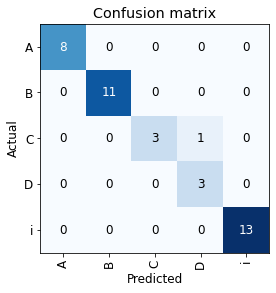

In [ ]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

### Export model to use later

In [ ]:
# Export model
learn.export()

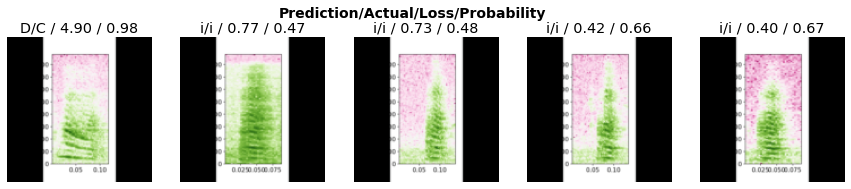

In [ ]:
interp.plot_top_losses(5, nrows=1)

In [ ]:
cleaner = ImageClassifierCleaner(learn)
cleaner


In [ ]:
for idx in cleaner.delete(): cleaner.fns[idx].unlink()
for idx,cat in w.change():
  if not os.path.exists(path):
    shutil.move(str(w.fns[idx]), path/cat)
  else:
    pass

# Use model to label new song file

### Load model

In [ ]:
# Set directory
%cd "/content/gdrive/My Drive"
path = Path()
# Check to see if the pkl file is there
path.ls(file_exts='.pkl')

/content/gdrive/My Drive


(#1) [Path('export.pkl')]

In [ ]:
# Load model
learn_inf = load_learner(path/'export.pkl')

### Upload file

In [ ]:
btn_upload = widgets.FileUpload()
btn_upload

FileUpload(value={}, description='Upload')

### Take a look at the file

In [ ]:
sound = btn_upload.data[-1]

In [ ]:

# Listen to the sound
Audio(sound)

In [ ]:
p='myfile.wav'
with open(p, mode='bw') as f:
    f.write(sound)

In [ ]:
btn_upload.value

{'G505_43739.37589170_10_1_10_26_29.wav': {'content': b'RIFF$P\x15\x00WAVEfmt \x10\x00\x00\x00\x01\x00\x01\x00D\xac\x00\x00\x88X\x01\x00\x02\x00\x10\x00data\x00\xa0*\x00\xcb\xff\xe3\xff\xf8\xff\xfd\xff\xe4\xff\xfb\xff\xd7\xff\xf3\xff\xfa\xff\xfb\xff\x03\x00\r\x00\x11\x00\x06\x00\xf7\xff\xf9\xff\x01\x00\xfc\xff\xf1\xff\xfb\xff\xe8\xff\x07\x00.\x00\x1f\x00A\x00N\x00a\x00p\x00]\x00@\x00\xff\xff\xc7\xff\x8f\xffi\xff{\xff\x8e\xff\xad\xff\xd0\xff\xdf\xff\xf2\xff\x14\x00\'\x00[\x00\x90\x00\x90\x00\xa5\x00\xa4\x00\xb9\x00\xae\x00\xa3\x00\x95\x00\x8a\x00P\x00O\x00!\x00\x0f\x00\xe5\xff\xc9\xff\x94\xffm\xffh\xffZ\xff\x8d\xffj\xff\xa2\xff\xc7\xff\xd0\xff\xab\xff\xc7\xff\xdd\xff\xcb\xff\xda\xff\x98\xffp\xff}\xffV\xff4\xffL\xff<\xff/\xffW\xff<\xffT\xff\x8c\xff\xc2\xff\xbd\xff\xca\xff\xc5\xff\xbf\xff\xb0\xff\xa4\xff\x98\xffc\xff&\xff\x17\xff\xed\xfe\xf2\xfe \xff\x1d\xffS\xff_\xff\x8b\xff\xc5\xff\x05\x00*\x00Y\x00S\x00a\x00Y\x007\x00$\x00\r\x00\xe9\xff\xd1\xff\xb2\xff\xb3\xff\xbb\xff\xc8\xff\xaf\xff\x

In [ ]:
str(btn_upload.value)

'{\'G505_43739.37589170_10_1_10_26_29.wav\': {\'metadata\': {\'lastModified\': 1604251279000, \'type\': \'audio/x-wav\', \'name\': \'G505_43739.37589170_10_1_10_26_29.wav\', \'size\': 2793516}, \'content\': b\'RIFF$P\\x15\\x00WAVEfmt \\x10\\x00\\x00\\x00\\x01\\x00\\x01\\x00D\\xac\\x00\\x00\\x88X\\x01\\x00\\x02\\x00\\x10\\x00data\\x00\\xa0*\\x00\\xcb\\xff\\xe3\\xff\\xf8\\xff\\xfd\\xff\\xe4\\xff\\xfb\\xff\\xd7\\xff\\xf3\\xff\\xfa\\xff\\xfb\\xff\\x03\\x00\\r\\x00\\x11\\x00\\x06\\x00\\xf7\\xff\\xf9\\xff\\x01\\x00\\xfc\\xff\\xf1\\xff\\xfb\\xff\\xe8\\xff\\x07\\x00.\\x00\\x1f\\x00A\\x00N\\x00a\\x00p\\x00]\\x00@\\x00\\xff\\xff\\xc7\\xff\\x8f\\xffi\\xff{\\xff\\x8e\\xff\\xad\\xff\\xd0\\xff\\xdf\\xff\\xf2\\xff\\x14\\x00\\\'\\x00[\\x00\\x90\\x00\\x90\\x00\\xa5\\x00\\xa4\\x00\\xb9\\x00\\xae\\x00\\xa3\\x00\\x95\\x00\\x8a\\x00P\\x00O\\x00!\\x00\\x0f\\x00\\xe5\\xff\\xc9\\xff\\x94\\xffm\\xffh\\xffZ\\xff\\x8d\\xffj\\xff\\xa2\\xff\\xc7\\xff\\xd0\\xff\\xab\\xff\\xc7\\xff\\xdd\\xff\\xcb\\xff\\xda\\xff\\x98

In [ ]:
# print original file name
re.search(r'[A-Z]\w+\.\w+.wav', str(btn_upload.value)).group(0)


'G505_43739.37589170_10_1_10_26_29.wav'

In [ ]:
# Get bird ID from file name
songfile = re.search(r'[A-Z]\w+\.\w+.wav', str(btn_upload.value)).group(0)
bird = songfile[0:4]
bird

'G505'

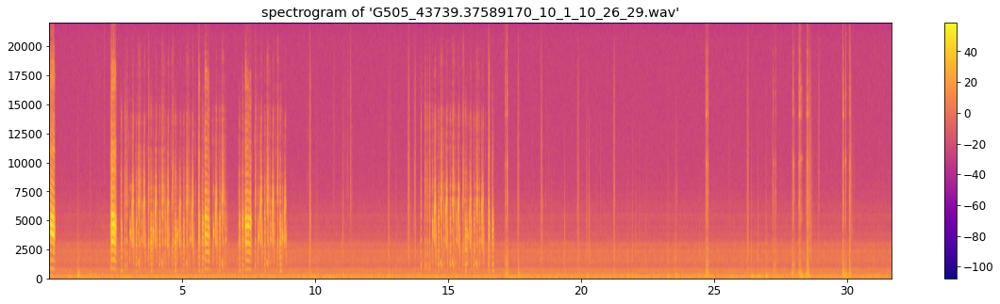

In [ ]:
# Visualize the sound
path = 'myfile.wav'
frame_rate, sound_info = wavfile.read(path)
plt.figure(num=None, figsize=(20, 5))
plt.specgram(sound_info, Fs=frame_rate, cmap = 'plasma')
plt.title('spectrogram of %r' % songfile)
plt.savefig('myfile.wav.png')
plt.colorbar()

### Process the file

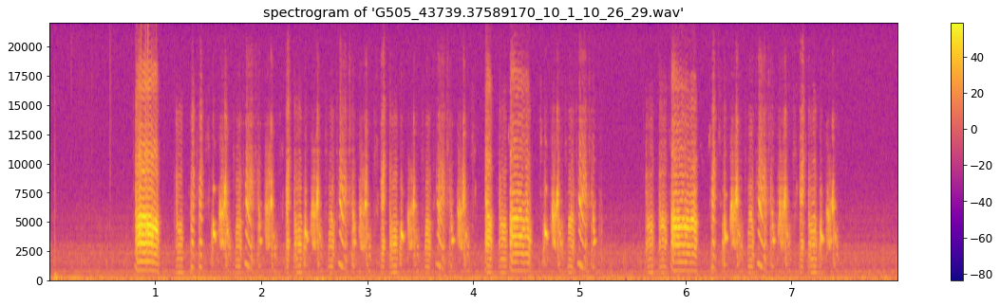

In [ ]:
# Cut up file so only songs are selected
segmented = AudioSegment.from_wav('myfile.wav')[1500:9500]
segmented.export("seg_myfile.wav", format='wav')
frame_rate, sound_info = wavfile.read('seg_myfile.wav')
plt.figure(num=None, figsize=(20, 5))
plt.specgram(sound_info, Fs=frame_rate, cmap = 'plasma')
plt.title('spectrogram of %r' % songfile)
plt.savefig('myfile.wav.png')
plt.colorbar()

In [ ]:
# Filter file high and low pass

sr, x = wavfile.read('seg_myfile.wav')      # 16-bit mono 44.1 khz

b1 = signal.firwin(101, cutoff=300, fs=sr, pass_zero='highpass')
b2 = signal.firwin(101, cutoff=20000, fs=sr, pass_zero='lowpass')

x = signal.lfilter(b1, [1.0], x)
x = signal.lfilter(b2, [1.0], x)

wavfile.write(songfile, sr, x.astype(np.int16))

In [ ]:
# Segment file
song = AudioSegment.from_wav('/content/gdrive/My Drive/'+songfile)
# Split track where the silence is 5 miliseconds or more and get chunks using 
# the imported function.
chunks = split_on_silence (
    # Use the loaded audio.
    song, 
    # Specify that a silent chunk must be at least 2 seconds or 2000 ms long.
    min_silence_len = 5,
    # Consider a chunk silent if it's quieter than -40 dBFS.
    # (You may want to adjust this parameter.)
    silence_thresh = -40
)

In [ ]:
len(chunks)

55

In [ ]:
chunks[0].duration_seconds


0.07

In [ ]:
chunks.index(chunks[0])

0

In [ ]:
round(chunks[0].dBFS) >-35

False

### Save chunk infomation in a table

In [ ]:
chunk_info = pd.DataFrame(columns=['name','duration','sound'])
for chunk in chunks:
  temp_dur = chunk.duration_seconds
  temp_sound = round(chunk.dBFS) > -35
  temp_name = 'chunk_'+ str(chunks.index(chunk))
  chunk_info = chunk_info.append({'name': temp_name,'duration':temp_dur,'sound':temp_sound},ignore_index=True)

chunk_info.head()


,name,duration,sound
0,chunk_0,0.070000,False
1,chunk_1,0.107982,False
2,chunk_2,0.408980,True
3,chunk_3,0.180000,True
4,chunk_4,0.093016,True


In [ ]:
len(chunk_info[chunk_info.sound==1])

48

### Prepare folders

In [ ]:
# Create file with the bird name if it doesn't exist already
p = "audio/chunks/"+bird
if not os.path.exists(p):
  os.mkdir(p)

In [ ]:
# Create file named chunks inside bird file
p = "audio/chunks/"+bird+"/chunks"
if not os.path.exists(p):
  os.mkdir(p)

In [ ]:
syllables= 'i','A','B','C','D'
clippath="audio/chunks/"+bird+"/clips"
if not os.path.exists(clippath):
  os.mkdir(clippath)
  for o in syllables:
    dest = (clippath/o)
    dest.mkdir(exist_ok=True)

In [ ]:
# export all audio segments into chunks folder if there's sound in it
for chunk in chunks:
  if round(chunk.dBFS) > -35:
    chunk.export("audio/chunks/"+bird+"/chunks/chunk_" + str(chunks.index(chunk)) + ".wav", format="wav")

In [ ]:
# Create file named images inside bird file
p = "audio/chunks/"+bird+"/images"
if not os.path.exists(p):
  os.mkdir(p)

In [ ]:
filenames = glob.glob("audio/chunks/"+bird+"/chunks/*.wav")
filenames[0:5]

['audio/chunks/G505/chunks/chunk_4.wav',
 'audio/chunks/G505/chunks/chunk_5.wav',
 'audio/chunks/G505/chunks/chunk_2.wav',
 'audio/chunks/G505/chunks/chunk_7.wav',
 'audio/chunks/G505/chunks/chunk_25.wav']

In [ ]:
filenames[0][25:len(filenames[0])]

'chunk_4.wav'

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """


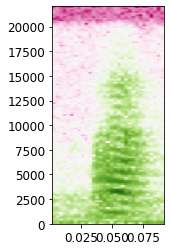

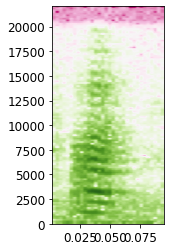

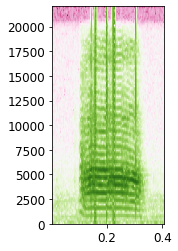

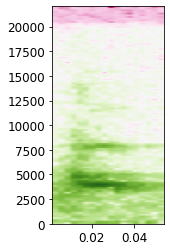

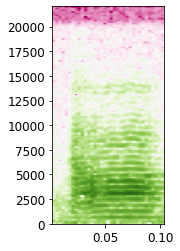

...

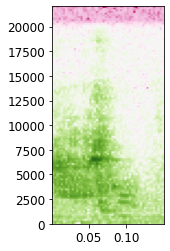

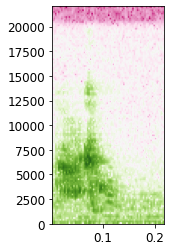

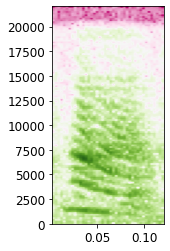

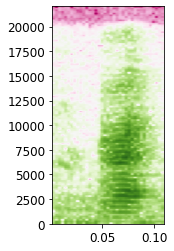

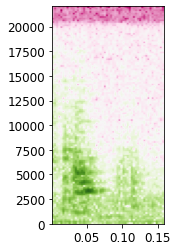

In [ ]:
# Turn interactive plotting off
plt.ioff()
for file in filenames:
  frame_rate, sound_info = wavfile.read(file)
  plt.figure(num=None, figsize=(2, 4))
  plt.specgram(sound_info, Fs=frame_rate, cmap = 'PiYG')
  plt.savefig('/content/gdrive/My Drive/audio/chunks/'+bird+'/images/'+file[25:len(file)]+".png")
  

In [ ]:
filenames = glob.glob("audio/chunks/"+bird+"/images/*.png")
filenames[0:5]

['audio/chunks/G505/images/chunk_2.wav.png',
 'audio/chunks/G505/images/chunk_3.wav.png',
 'audio/chunks/G505/images/chunk_4.wav.png',
 'audio/chunks/G505/images/chunk_5.wav.png',
 'audio/chunks/G505/images/chunk_7.wav.png']

In [ ]:
filenamelist = re.findall('(chunk_\d+\.wav\.png)', str(filenames))
filenamelist[0:5]

['chunk_2.wav.png',
 'chunk_3.wav.png',
 'chunk_4.wav.png',
 'chunk_5.wav.png',
 'chunk_7.wav.png']

In [ ]:
filenamelist = re.findall('(chunk_\d+)\.wav\.png', str(filenames))
filenamelist[0:5]

['chunk_2', 'chunk_3', 'chunk_4', 'chunk_5', 'chunk_7']

In [ ]:
re.findall('(chunk_\d+)\.wav\.png', str(filenames[0]))

['chunk_2']

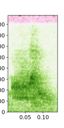

In [ ]:
img = PILImage.create(filenames[5])
display(img.to_thumb(128,128))

### Predict syllables using model

In [ ]:
path = Path()
path.ls(file_exts='.pkl')

(#1) [Path('export.pkl')]

In [ ]:
# load trained model

chunk_info['pred'] = np.nan
learn_inf = load_learner(path/'export.pkl')
# loop through new images and get predictions
for file in filenames:
  img = PILImage.create(file)
  pred,pred_idx,probs = learn_inf.predict(img)
  filename = re.findall('(chunk_\d+)\.wav\.png', str(file))[0]
  chunk_info.loc[chunk_info.name==filename,'pred'] = pred

chunk_info.head()

,name,duration,sound,pred
0,chunk_0,0.070000,False,NaN
1,chunk_1,0.107982,False,NaN
2,chunk_2,0.408980,True,B
3,chunk_3,0.180000,True,B
4,chunk_4,0.093016,True,A


In [ ]:
chunk_info['percent'] = chunk_info['duration']/chunk_info.duration.sum()

chunk_info.head()

,name,duration,sound,pred,percent
0,chunk_0,0.070000,False,NaN,0.010397
1,chunk_1,0.107982,False,NaN,0.016038
2,chunk_2,0.408980,True,B,0.060743
3,chunk_3,0.180000,True,B,0.026734
4,chunk_4,0.093016,True,A,0.013815


In [ ]:
chunk_info.loc[0:2,'percent'].sum()

0.08717719012272498

In [ ]:
rows = range(0,len(chunk_info))
for row in rows:
  chunk_info.loc[row,'cum_percent'] = chunk_info.loc[0:row,'percent'].sum()
chunk_info.head()

,name,duration,sound,pred,percent,cum_percent
0,chunk_0,0.070000,False,NaN,0.010397,0.010397
1,chunk_1,0.107982,False,NaN,0.016038,0.026434
2,chunk_2,0.408980,True,B,0.060743,0.087177
3,chunk_3,0.180000,True,B,0.026734,0.113911
4,chunk_4,0.093016,True,A,0.013815,0.127726


Text(100, 100, 'B')

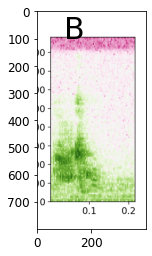

In [ ]:
import matplotlib.image as mpimg
imgplot = plt.imshow(img)
plt.text(100,100,pred, fontsize=30)

In [ ]:
chunk_info.loc[1,'percent']

0.016037773975832195

In [ ]:

fig= plt.figure(figsize=(20,10))
fig.show()

<Figure size 1440x720 with 0 Axes>

In [ ]:
chunk_info_pos = chunk_info.dropna().reset_index(drop=True)
chunk_info_pos[-1:]

,name,duration,sound,pred,percent,cum_percent
47,chunk_54,0.218005,True,B,0.032379,1.0


In [ ]:
len(chunk_info_pos)

48

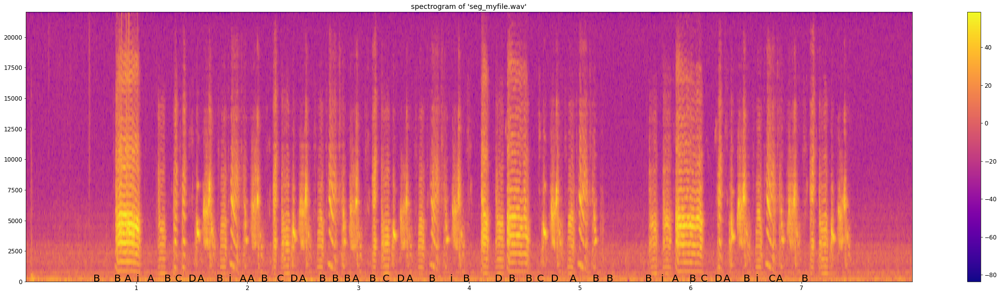

In [ ]:
path = 'seg_myfile.wav'
chunk_info_pos = chunk_info.dropna().reset_index(drop=True)
frame_rate, sound_info = wavfile.read(path)
plt.figure(num=None, figsize=(40, 10))
plt.specgram(sound_info, Fs=frame_rate, cmap = 'plasma')
plt.title('spectrogram of %r' % path)
rows = range(0,len(chunk_info_pos))
for row in rows:
  percent = chunk_info_pos.loc[row,'cum_percent']*7
  pred = chunk_info_pos.loc[row,'pred']
  plt.text(percent,2.5,str(pred), fontsize=20)
plt.colorbar()

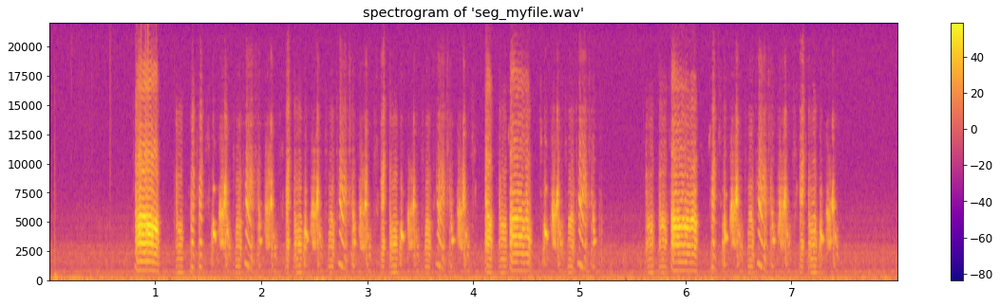

In [ ]:
path = 'seg_myfile.wav'
chunk_info_pos = chunk_info.dropna().reset_index(drop=True)
frame_rate, sound_info = wavfile.read(path)
plt.figure(num=None, figsize=(20, 5))
plt.specgram(sound_info, Fs=frame_rate, cmap = 'plasma')
plt.title('spectrogram of %r' % path)
rows = range(0,len(chunk_info_pos))

plt.colorbar()

In [ ]:
%ls 'audio/chunks/G505/images/'

chunk_10.wav.png  chunk_25.wav.png  chunk_37.wav.png  chunk_48.wav.png
chunk_12.wav.png  chunk_26.wav.png  chunk_38.wav.png  chunk_49.wav.png
chunk_13.wav.png  chunk_27.wav.png  chunk_39.wav.png  chunk_4.wav.png
chunk_14.wav.png  chunk_28.wav.png  chunk_3.wav.png   chunk_50.wav.png
chunk_15.wav.png  chunk_29.wav.png  chunk_40.wav.png  chunk_51.wav.png
chunk_16.wav.png  chunk_2.wav.png   chunk_41.wav.png  chunk_52.wav.png
chunk_17.wav.png  chunk_31.wav.png  chunk_42.wav.png  chunk_53.wav.png
chunk_19.wav.png  chunk_32.wav.png  chunk_43.wav.png  chunk_54.wav.png
chunk_20.wav.png  chunk_33.wav.png  chunk_44.wav.png  chunk_5.wav.png
chunk_21.wav.png  chunk_34.wav.png  chunk_45.wav.png  chunk_7.wav.png
chunk_23.wav.png  chunk_35.wav.png  chunk_46.wav.png  chunk_8.wav.png
chunk_24.wav.png  chunk_36.wav.png  chunk_47.wav.png  chunk_9.wav.png
